# Pre-requisites

In [1]:
import langchain as lc
print("LangChain version:", lc.__version__)
!python -V

LangChain version: 1.2.6
Python 3.11.0


# Model Setup

In [2]:
from langchain_huggingface import HuggingFaceEndpoint, ChatHuggingFace

# Use HuggingFaceEndpoint - automatic routing based on availability
llm = HuggingFaceEndpoint(
    repo_id="Qwen/Qwen2.5-14B-Instruct",
    task="text-generation",
    max_new_tokens=512,
    temperature=0.1,
)

chat_llm = ChatHuggingFace(llm=llm)

# Simple Calculator Tool

In [3]:
from langchain_core.tools import tool
from math import pi

@tool
def calculate_circumference(radius: float) -> float:
    """Calculate the circumference of a circle given its radius.
    Args:
        radius: The radius of the circle in units
    Returns:
        The circumference of the circle in the same units
    """
    return 2 * pi * radius

In [4]:
from langchain_core.prompts import ChatPromptTemplate, MessagesPlaceholder
from langchain_core.messages import HumanMessage, AIMessage, ToolMessage

# Define your tools list
tools = [calculate_circumference]

class CustomAgentExecutor:
    def __init__(
        self,
        prompt: ChatPromptTemplate,
        tools: list,
        llm: ChatHuggingFace,
        max_iterations: int = 3
    ):
        self.chat_history = []
        self.max_iterations = max_iterations
        self.name2tool = {tool.name: tool.func for tool in tools}
        self.agent = (
            {
                "input": lambda x: x["input"],
                "chat_history": lambda x: x["chat_history"],
                "agent_scratchpad": lambda x: x.get("agent_scratchpad", [])
            }
            | prompt
            | llm.bind_tools(tools)
        )

    def invoke(self, input: str, verbose: bool = False) -> dict:
        count = 0
        agent_scratchpad = []

        while count < self.max_iterations:
            # Get tool call from agent
            response = self.agent.invoke({
                "input": input,
                "chat_history": self.chat_history,
                "agent_scratchpad": agent_scratchpad
            })
            if verbose:
                print(f"Response: {response}")

            # Add response to scratchpad
            agent_scratchpad.append(response)

            # If no tool calls, we have our answer
            if not response.tool_calls:
                self.chat_history.extend([
                    HumanMessage(content=input),
                    AIMessage(content=response.content)
                ])
                return {"answer": response.content}

            # Execute tool
            tool_call = response.tool_calls[0]
            tool_name = tool_call["name"]
            tool_args = tool_call["args"]

            # Find and execute the tool
            tool_output = self.name2tool[tool_name](**tool_args)

            # Add tool output to scratchpad
            agent_scratchpad.append(
                ToolMessage(
                    content=str(tool_output),
                    tool_call_id=tool_call["id"]
                )
            )

            count += 1

        # Update chat history with final result
        self.chat_history.extend([
            HumanMessage(content=input),
            AIMessage(content=str(tool_output))
        ])

        return {"answer": str(tool_output)}

In [5]:
sys_msg = """Assistant is a large language model.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

For mathematical calculations, Assistant always uses its provided tools to ensure perfect accuracy and consistency. Even for simple calculations, Assistant relies on these tools rather than performing calculations itself, as this guarantees precise, verifiable results every time.

Overall, Assistant is a powerful system that can help with a wide range of tasks and provide valuable insights and information on a wide range of topics. Whether you need help with a specific question or just want to have a conversation about a particular topic, Assistant is here to assist.
"""

# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    ("placeholder", "{agent_scratchpad}"),
])

agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=chat_llm,
    max_iterations=3
)

In [6]:
result = agent_executor.invoke("can you calculate the circumference of a circle that has a radius of 7.81mm", verbose=True)
result

Response: content='' additional_kwargs={'tool_calls': [{'function': {'arguments': '{"radius":7.81}', 'name': 'calculate_circumference', 'description': None}, 'id': 'qwen-0-1771625292123', 'type': 'function'}]} response_metadata={'token_usage': {'completion_tokens': 25, 'prompt_tokens': 467, 'total_tokens': 492}, 'model_name': 'Qwen/Qwen2.5-14B-Instruct', 'system_fingerprint': '', 'finish_reason': 'tool_calls', 'logprobs': None} id='lc_run--019c7d18-7bbb-75d2-b314-e2ae233cd1dc-0' tool_calls=[{'name': 'calculate_circumference', 'args': {'radius': 7.81}, 'id': 'qwen-0-1771625292123', 'type': 'tool_call'}] invalid_tool_calls=[] usage_metadata={'input_tokens': 467, 'output_tokens': 25, 'total_tokens': 492}
Response: content='The circumference of a circle with a radius of 7.81 mm is approximately 49.07 mm.' additional_kwargs={} response_metadata={'token_usage': {'completion_tokens': 25, 'prompt_tokens': 529, 'total_tokens': 554}, 'model_name': 'Qwen/Qwen2.5-14B-Instruct', 'system_fingerprint

{'answer': 'The circumference of a circle with a radius of 7.81 mm is approximately 49.07 mm.'}

# Tools with Multiple Parameters

In [7]:
from typing import Optional
from math import sqrt, cos, sin

desc = (
    "use this tool when you need to calculate the length of an hypotenuse "
    "given one or two sides of a triangle and/or an angle (in degrees). "
    "To use the tool you must provide at least two of the following parameters "
    "['adjacent_side', 'opposite_side', 'angle']."
)

@tool
def calculate_hypotenuse(
    adjacent_side: Optional[float] = None,
    opposite_side: Optional[float] = None,
    angle: Optional[float] = None
) -> float:
    """Calculate the hypotenuse of a triangle given sides and/or angle."""
    if adjacent_side and opposite_side:
        return sqrt(float(adjacent_side)**2 + float(opposite_side)**2)
    elif adjacent_side and angle:
        return adjacent_side / cos(float(angle))
    elif opposite_side and angle:
        return opposite_side / sin(float(angle))
    else:
        return "Could not calculate the hypotenuse. Need two or more parameters."

tools = [calculate_hypotenuse]

In [8]:
# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    MessagesPlaceholder(variable_name="agent_scratchpad"),
])


agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=chat_llm,
    max_iterations=3
)

In [9]:
agent_executor.invoke(
    "If I have a triangle with two sides of length 51cm and 34cm, what is the length of the hypotenuse?",
    verbose=True
)

Response: content='' additional_kwargs={'tool_calls': [{'function': {'arguments': '{"adjacent_side":51,"opposite_side":34,"angle":null}', 'name': 'calculate_hypotenuse', 'description': None}, 'id': 'qwen-0-1771625860719', 'type': 'function'}]} response_metadata={'token_usage': {'completion_tokens': 39, 'prompt_tokens': 496, 'total_tokens': 535}, 'model_name': 'Qwen/Qwen2.5-14B-Instruct', 'system_fingerprint': '', 'finish_reason': 'tool_calls', 'logprobs': None} id='lc_run--019c7d20-d1bb-73f2-86f7-8ca0c57ed55a-0' tool_calls=[{'name': 'calculate_hypotenuse', 'args': {'adjacent_side': 51, 'opposite_side': 34, 'angle': None}, 'id': 'qwen-0-1771625860719', 'type': 'tool_call'}] invalid_tool_calls=[] usage_metadata={'input_tokens': 496, 'output_tokens': 39, 'total_tokens': 535}
Response: content='The length of the hypotenuse for a triangle with sides measuring 51 cm and 34 cm is approximately 61.29 cm.' additional_kwargs={} response_metadata={'token_usage': {'completion_tokens': 32, 'prompt_

{'answer': 'The length of the hypotenuse for a triangle with sides measuring 51 cm and 34 cm is approximately 61.29 cm.'}

# More Advanced Tool Usage

In [10]:
import torch
from transformers import BlipProcessor, BlipForConditionalGeneration

hf_model = "Salesforce/blip-image-captioning-large"
device = 'cuda' if torch.cuda.is_available() else 'cpu'

processor = BlipProcessor.from_pretrained(hf_model)
model = BlipForConditionalGeneration.from_pretrained(hf_model).to(device)

2026-02-21 03:49:41.979142: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/445 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/527 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.88G [00:00<?, ?B/s]

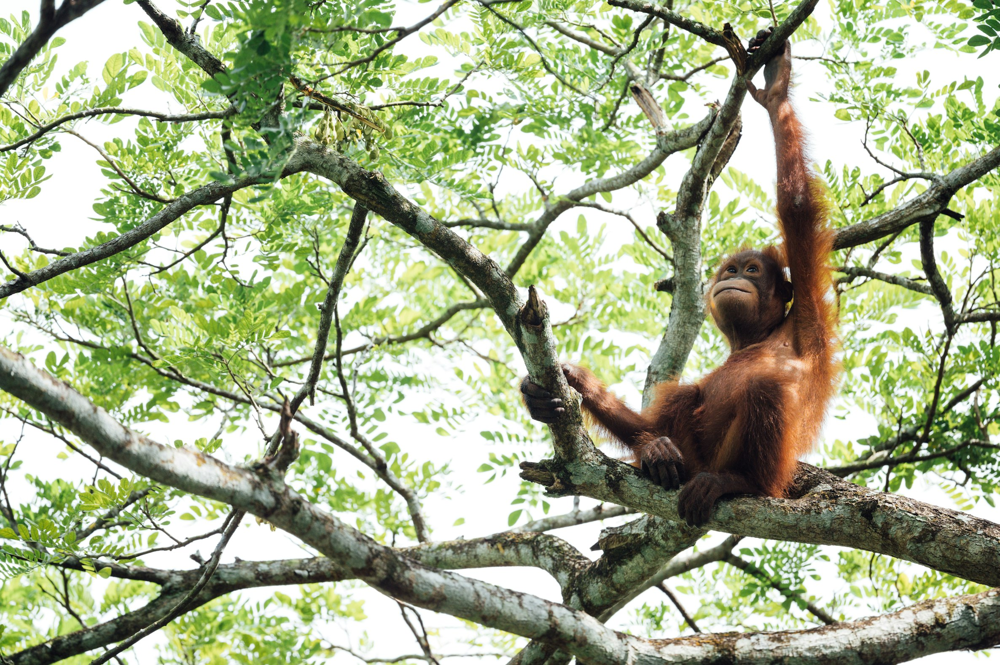

In [11]:
import requests
from PIL import Image

img_url = 'https://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80'
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [12]:
# unconditional image captioning
inputs = processor(image, return_tensors="pt").to(device)

out = model.generate(**inputs, max_new_tokens=20)
print(processor.decode(out[0], skip_special_tokens=True))

there is a monkey that is sitting in a tree


In [13]:
desc = (
    "use this tool when given the URL of an image that you'd like to be "
    "described. It will return a simple caption describing the image."
)

@tool
def caption_image(url: str) -> str:
    """Generate a caption for an image given its URL."""
    image = Image.open(requests.get(url, stream=True).raw).convert('RGB')
    inputs = processor(image, return_tensors="pt").to(device)
    out = model.generate(**inputs, max_new_tokens=20)
    return processor.decode(out[0], skip_special_tokens=True)

tools = [caption_image]

In [14]:
sys_msg = """Assistant is a large language model.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

Overall, Assistant is a powerful system that can help with a wide range of tasks and provide valuable insights and information on a wide range of topics. Whether you need help with a specific question or just want to have a conversation about a particular topic, Assistant is here to assist.
"""

# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    MessagesPlaceholder(variable_name="agent_scratchpad"),
])

agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=chat_llm,
    max_iterations=3
)

In [15]:
agent_executor.invoke(f"What does this image show?\n{img_url}")

{'answer': 'The image shows a monkey sitting in a tree.'}

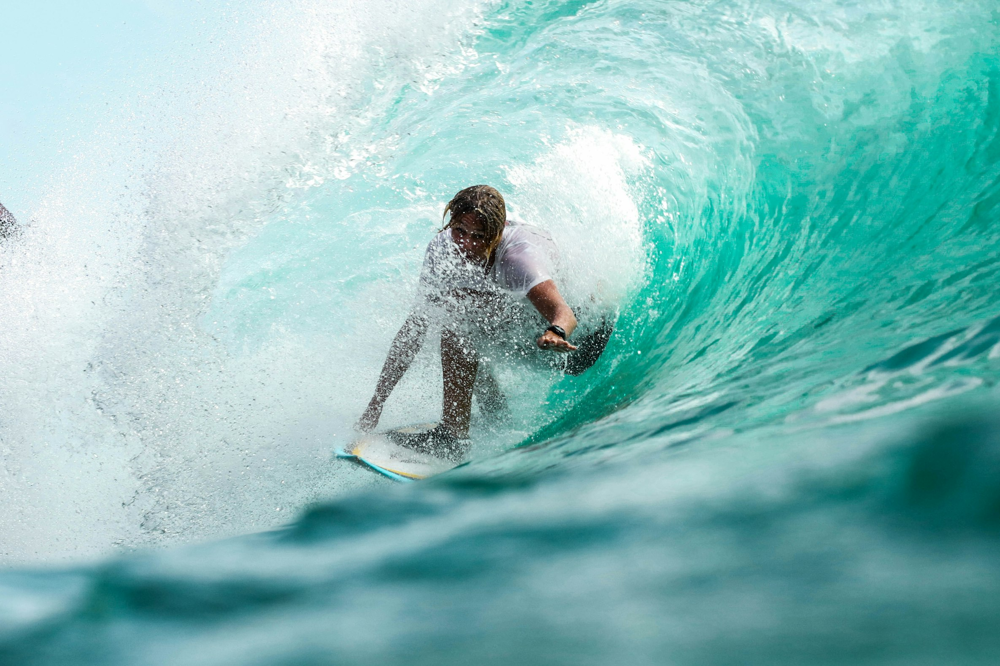

In [16]:
img_url = "https://images.unsplash.com/photo-1502680390469-be75c86b636f?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2370&q=80"
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [17]:
agent_executor.invoke(f"what is in this image?\n{img_url}")

{'answer': 'The image shows a surfer riding a wave in the ocean on a clear day.'}

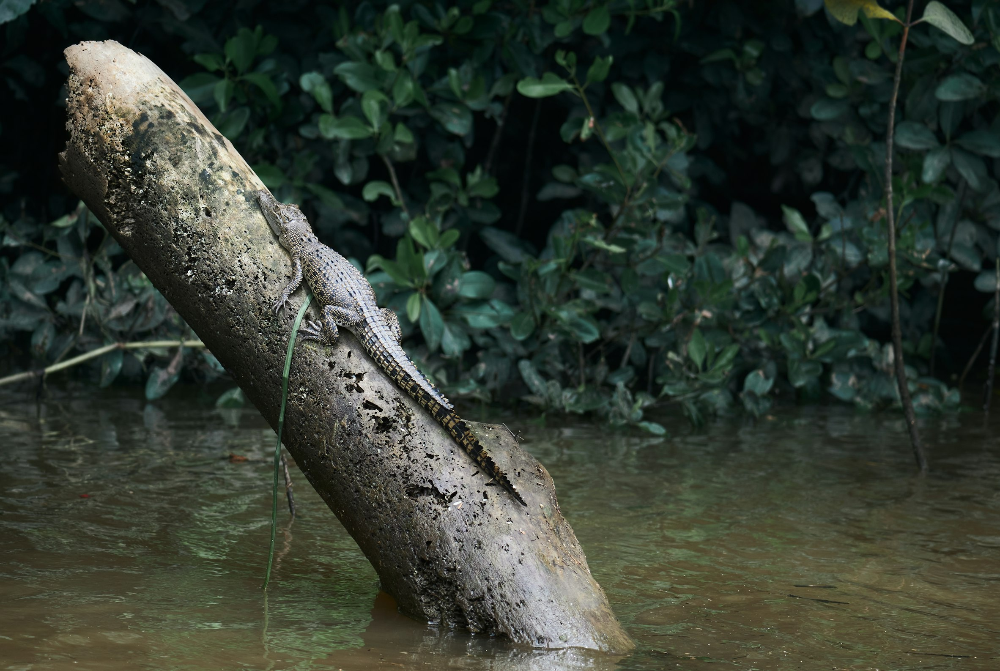

In [18]:
img_url = "https://images.unsplash.com/photo-1680382948929-2d092cd01263?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2365&q=80"
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [19]:
agent_executor.invoke(f"what is in this image?\n{img_url}")

{'answer': 'The image shows a lizard sitting on a tree branch that is in the water.'}